In [1]:
# Import libraries
from cnn.exonet_dataset import ExonetDataset
from utils import load_state, save_state

import math
import torch
import numpy as np
import pandas as pd
import warnings
import matplotlib.pyplot as plt
import torch.nn.functional as F

from PIL import Image
from tqdm import tqdm
from pathlib import Path
from torchvision import models
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
from sklearn.preprocessing import LabelEncoder
from torch.utils.data import Dataset, DataLoader
from torchvision.transforms import v2 as transforms

from pytorch_grad_cam import GradCAM, HiResCAM, ScoreCAM, GradCAMPlusPlus, AblationCAM, XGradCAM, EigenCAM, FullGrad
from pytorch_grad_cam.utils.model_targets import ClassifierOutputTarget
from pytorch_grad_cam.utils.image import show_cam_on_image

In [2]:
# Define seed for random
SEED = 42
np.random.seed(SEED)
torch.manual_seed(SEED)

In [3]:
# Import real dataset
labels_path = Path("F:\\Datasets\\Tesis\\labels_df.pkl")
exonet_dir_path = Path("F:\\ExoNet_Images\\ExoNet_Images")
df = pd.read_pickle(labels_path)

df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 922782 entries, 0 to 922781
Data columns (total 4 columns):
 #   Column  Non-Null Count   Dtype 
---  ------  --------------   ----- 
 0   video   922782 non-null  object
 1   frame   922782 non-null  int64 
 2   class   922782 non-null  object
 3   exist   922782 non-null  bool  
dtypes: bool(1), int64(1), object(2)
memory usage: 22.0+ MB


In [4]:
# Group images per class and count how many images exist per class
df.groupby(["class"])[["frame"]].count().sort_values(by=["frame"])

,frame
class,
IS-T-LG,11040
IS-S,17357
DW-T-O,19150
LG-T-DS,22607
LG-T-IS,26067
DS-T-LG,28677
IS-T-DW,31628
DW-S,36710
LG-S,77576


In [42]:
# Get an equal number of images per class and let remaining images for testing
TRAIN_IMAGES_PER_CLASS = 2000
VAL_IMAGES_PER_CLASS = math.ceil(TRAIN_IMAGES_PER_CLASS * 0.2)
TEST_IMAGES_PER_CLASS = math.ceil(TRAIN_IMAGES_PER_CLASS * 0.1)

print(f"Images per class for training: {TRAIN_IMAGES_PER_CLASS}")
print(f"Images per class for validation: {VAL_IMAGES_PER_CLASS}")
print(f"Images per class for testing: {TEST_IMAGES_PER_CLASS}")

def generate_fair_dataset(df, classes, class_column_name="class"):
    train_df, val_df, test_df = None, None, None
    for _class in classes:
        _df = df[df[class_column_name] == _class]
        sample = _df.sample(
            TRAIN_IMAGES_PER_CLASS +
            VAL_IMAGES_PER_CLASS +
            TEST_IMAGES_PER_CLASS,
            random_state=SEED
        )
        train_df = pd.concat([train_df, sample.iloc[:TRAIN_IMAGES_PER_CLASS,:]]).reset_index(drop=True)
        val_df = pd.concat([val_df, sample.iloc[TRAIN_IMAGES_PER_CLASS:TRAIN_IMAGES_PER_CLASS+VAL_IMAGES_PER_CLASS,:]]).reset_index(drop=True)
        test_df = pd.concat([test_df, sample.iloc[TRAIN_IMAGES_PER_CLASS+VAL_IMAGES_PER_CLASS:,:]]).reset_index(drop=True)

    return train_df, val_df, test_df

classes = df['class'].unique()
train_df, val_df, test_df = generate_fair_dataset(df, classes)
print(f"Train df rows: {len(train_df)}\nValidation df rows: {len(val_df)}\nTest df rows: {len(test_df)}")

Images per class for training: 2000
Images per class for validation: 400
Images per class for testing: 200
Train df rows: 24000
Validation df rows: 4800
Test df rows: 2400


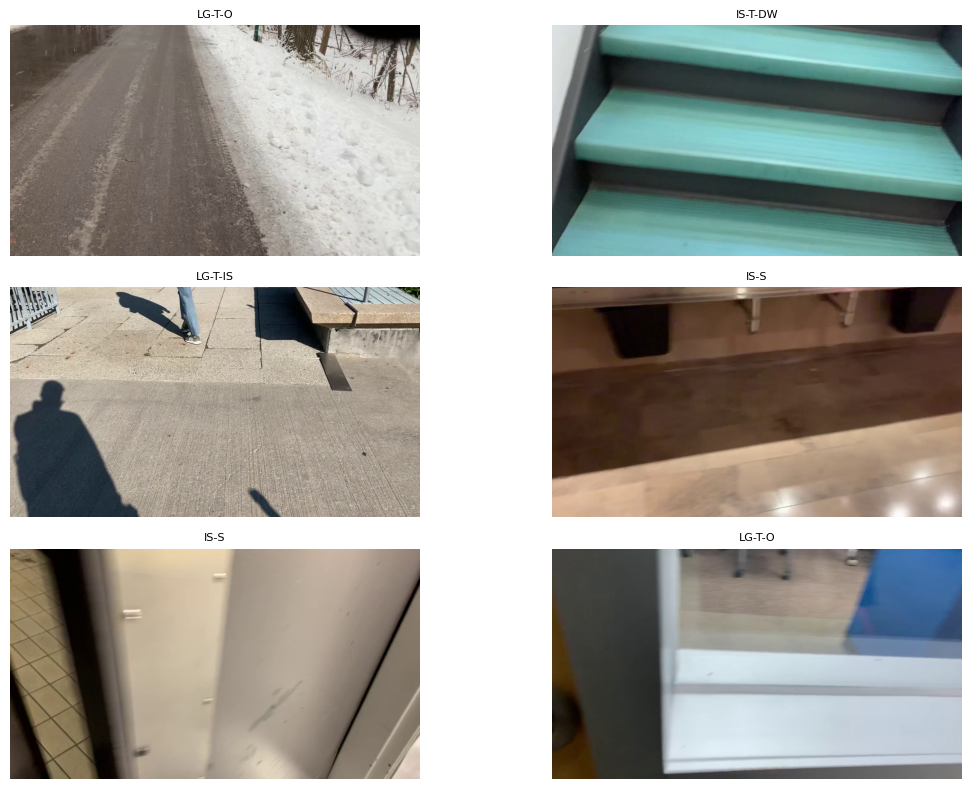

In [6]:
# Plot random images
def plot_images(image_paths, titles, cols=2, figsize=(12, 8)):
    n_images = len(image_paths)
    rows = math.ceil(n_images / cols)

    fig, axes = plt.subplots(rows, cols, figsize=figsize)
    axes = axes.flatten() if rows * cols > 1 else [axes]

    for ax, img_path, title in zip(axes, image_paths, titles):
        try:
            img = Image.open(img_path)
            ax.imshow(img)
            ax.set_title(title, fontsize=8)
            ax.axis("off")
        except Exception as e:
            ax.text(0.5, 0.5, f"Error\n{e}", ha="center", va="center")
            ax.axis("off")

    # Hide empty subplots if any
    for ax in axes[n_images:]:
        ax.axis("off")

    plt.tight_layout()
    plt.show()

_images = train_df.sample(6, random_state=SEED)
_image_paths = [exonet_dir_path / row["class"] / "['{}'] frame {}.jpg".format(row["video"], row["frame"]) for _, row in _images.iterrows()]
_image_classes = [row["class"] for _, row in _images.iterrows()]
plot_images(_image_paths, _image_classes)

In [7]:
def get_efficientnet_b7(fine_tuning=False, last_layers=4):
    # Load pre-trained model
    pre_model = models.efficientnet_b5(weights=models.EfficientNet_B5_Weights.IMAGENET1K_V1)
    
    # Unfreeze classifier params
    for param in pre_model.classifier.parameters():
        param.requires_grad = True
    
    # Freeze hidden layers if fine_tuning = False
    for param in pre_model.features.parameters():
        param.requires_grad = False
        
    if fine_tuning:    
        for param in pre_model.features[-last_layers].parameters():
            param.requires_grad = True
            
    # Define custom classifier
    in_features = pre_model.classifier[1].in_features
    
    pre_model.classifier = torch.nn.Sequential(
        torch.nn.Dropout(p=0.5, inplace=True), # Keep the original Dropout layer
        torch.nn.Linear(in_features, len(classes))
    )
    
    # Move the model to the appropriate device
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    pre_model.to(device)

    return pre_model, device

In [8]:
pre_model, device = get_efficientnet_b7()

In [9]:
def setup_training_params(model, optimizer, checkpoint_path, scheduler=None):
    # set initial values
    epoch = 0
    history = {
        "train_loss": [],
        "val_loss": [],
        "train_acc": [],
        "val_acc": [],
        "best_val_acc": 0
    }

    # load checkpoint if any
    checkpoint = load_state(checkpoint_path, device)
    if not checkpoint:
        return model, optimizer, history, epoch, scheduler

    history = {
        "train_loss": checkpoint["history"]["train_loss"],
        "val_loss": checkpoint["history"]["val_loss"],
        "train_acc": checkpoint["history"]["train_acc"],
        "val_acc": checkpoint["history"]["val_acc"],
        "best_val_acc": checkpoint["history"]["best_val_acc"]
    }

    model.load_state_dict(checkpoint["model_state_dict"])
    optimizer.load_state_dict(checkpoint["optimizer_state_dict"])
    epoch = checkpoint["current_epoch"]
    if scheduler:
        scheduler.load_state_dict(checkpoint["scheduler"])

    return model, optimizer, history, epoch, scheduler
    
    
# function for training process
def train_model(
    model, 
    criterion, 
    optimizer, 
    train_loader, 
    val_loader, 
    num_epochs,
    device, 
    checkpoint_path,
    checkpoint_path_best,
    current_epoch,
    history,
    scheduler=None
):
       
    for epoch in range(current_epoch, num_epochs):
        # --- Training Phase ---
        model.train()
        running_loss = 0.0
        correct_train = 0
        total_train = 0
        
        # Initialize tqdm for the training loader
        train_bar = tqdm(train_loader, desc=f"Epoch {epoch+1}/{num_epochs} [Train]", unit="batch")
        
        for inputs, labels in train_bar:
            inputs, labels = inputs.to(device), labels.to(device)

            # Zero the parameter gradients
            optimizer.zero_grad()

            # Forward pass
            outputs = model(inputs)
            loss = criterion(outputs, labels)

            # Backward pass and optimization
            loss.backward()
            optimizer.step()

            # Statistics
            running_loss += loss.item() * inputs.size(0)
            _, predicted = torch.max(outputs.data, 1)
            total_train += labels.size(0)
            correct_train += (predicted == labels).sum().item()
            
            # Update tqdm progress bar description
            train_bar.set_postfix({'loss': loss.item(), 'acc': f"{(correct_train/total_train):.4f}"})

        # Update scheduler if any is provided
        if scheduler:
            scheduler.step()
        save_state(checkpoint_path, model, optimizer, epoch+1, history, scheduler)
        epoch_loss = running_loss / len(train_dataset)
        epoch_acc = correct_train / total_train
        
        # --- Validation Phase ---
        model.eval()
        val_loss = 0.0
        correct_val = 0
        total_val = 0
        
        with torch.no_grad():
            # Initialize tqdm for the validation loader
            val_bar = tqdm(val_loader, desc=f"Epoch {epoch+1}/{num_epochs} [Val]", unit="batch")
            
            for inputs, labels in val_bar:
                inputs, labels = inputs.to(device), labels.to(device)
                
                outputs = model(inputs)
                loss = criterion(outputs, labels)
                
                val_loss += loss.item() * inputs.size(0)
                _, predicted = torch.max(outputs.data, 1)
                total_val += labels.size(0)
                correct_val += (predicted == labels).sum().item()

                val_bar.set_postfix({'loss': loss.item(), 'acc': f"{(correct_val/total_val):.4f}"})
        
        val_epoch_loss = val_loss / len(val_dataset)
        val_epoch_acc = correct_val / total_val

        if val_epoch_acc > history["best_val_acc"]:
            history["best_val_acc"] = val_epoch_acc
            save_state(checkpoint_path_best, model, optimizer, epoch, history, scheduler)

        print(f"\nEpoch {epoch+1} Summary:")
        print(f"  Train Loss: {epoch_loss:.4f} | Train Acc: {epoch_acc:.4f}")
        print(f"  Val Loss:   {val_epoch_loss:.4f} | Val Acc:   {val_epoch_acc:.4f}")

    print("\nTraining complete!")
    return model

In [10]:
# Create target transform
target_transform = LabelEncoder()
target_transform.fit(classes)

def create_dataset(df, target_transform=target_transform, virtual_classname=None):
    return ExonetDataset(
        df=df,
        base_dir=Path("F:\\ExoNet_Images\\ExoNet_Images"),
        virtual_classname=virtual_classname,
        transform=models.EfficientNet_B5_Weights.IMAGENET1K_V1.transforms(),
        target_transform=target_transform.transform
    )
    

In [11]:
# Create dataset
train_dataset = create_dataset(train_df)
val_dataset = create_dataset(val_df)

# Create dataloaders
train_loader = DataLoader(
    train_dataset,
    batch_size=128,
    shuffle=True,
    num_workers=4,
    pin_memory=True
)
val_loader = DataLoader(
    val_dataset,
    batch_size=128,
    shuffle=True,
    num_workers=4,
    pin_memory=True
)

# define criterion and optimizers
criterion = torch.nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(pre_model.classifier.parameters(), lr=1e-3)
epochs = 40
lr_decay_scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimizer, T_max=epochs, eta_min=1e-4)
checkpoint_path = "states\\transfer_learning_efficientnetb5.pth"
checkpoint_path_best = "states\\transfer_learning_efficientnetb5_best.pth"

In [26]:
# Retrieve previous training progress
pre_model, optimizer, history, current_epoch, lr_decay_scheduler = setup_training_params(
    pre_model,
    optimizer,
    checkpoint_path,
    lr_decay_scheduler
)

pre_model = train_model(
    pre_model,
    criterion,
    optimizer,
    train_loader,
    val_loader,
    epochs,
    device,
    checkpoint_path,
    checkpoint_path_best,
    current_epoch,
    history,
    lr_decay_scheduler
)

The state couldn't be loaded. Exception: [Errno 2] No such file or directory: 'states\\transfer_learning_efficientnetb5.pth'


Epoch 1/40 [Val]: 100%|███████████████████████████████████████| 38/38 [00:28<00:00,  1.34batch/s, loss=1.8, acc=0.4240]



Epoch 1 Summary:
  Train Loss: 1.9900 | Train Acc: 0.3542
  Val Loss:   1.7619 | Val Acc:   0.4240


Epoch 2/40 [Val]: 100%|███████████████████████████████████████| 38/38 [00:30<00:00,  1.26batch/s, loss=1.7, acc=0.4473]



Epoch 2 Summary:
  Train Loss: 1.7671 | Train Acc: 0.4224
  Val Loss:   1.7090 | Val Acc:   0.4473


Epoch 3/40 [Val]: 100%|██████████████████████████████████████| 38/38 [00:31<00:00,  1.20batch/s, loss=1.83, acc=0.4542]



Epoch 3 Summary:
  Train Loss: 1.7152 | Train Acc: 0.4336
  Val Loss:   1.6879 | Val Acc:   0.4542


Epoch 4/40 [Val]: 100%|██████████████████████████████████████| 38/38 [00:28<00:00,  1.35batch/s, loss=1.68, acc=0.4519]



Epoch 4 Summary:
  Train Loss: 1.6898 | Train Acc: 0.4458
  Val Loss:   1.6734 | Val Acc:   0.4519


Epoch 5/40 [Val]: 100%|██████████████████████████████████████| 38/38 [00:29<00:00,  1.27batch/s, loss=1.85, acc=0.4615]



Epoch 5 Summary:
  Train Loss: 1.6737 | Train Acc: 0.4490
  Val Loss:   1.6617 | Val Acc:   0.4615


Epoch 6/40 [Val]: 100%|██████████████████████████████████████| 38/38 [00:31<00:00,  1.19batch/s, loss=1.67, acc=0.4617]



Epoch 6 Summary:
  Train Loss: 1.6649 | Train Acc: 0.4522
  Val Loss:   1.6569 | Val Acc:   0.4617


Epoch 7/40 [Val]: 100%|██████████████████████████████████████| 38/38 [00:28<00:00,  1.32batch/s, loss=1.56, acc=0.4646]



Epoch 7 Summary:
  Train Loss: 1.6540 | Train Acc: 0.4531
  Val Loss:   1.6506 | Val Acc:   0.4646


Epoch 8/40 [Val]: 100%|██████████████████████████████████████| 38/38 [00:30<00:00,  1.25batch/s, loss=1.55, acc=0.4677]



Epoch 8 Summary:
  Train Loss: 1.6529 | Train Acc: 0.4519
  Val Loss:   1.6479 | Val Acc:   0.4677


Epoch 9/40 [Val]: 100%|██████████████████████████████████████| 38/38 [00:32<00:00,  1.19batch/s, loss=1.65, acc=0.4658]



Epoch 9 Summary:
  Train Loss: 1.6517 | Train Acc: 0.4565
  Val Loss:   1.6458 | Val Acc:   0.4658


Epoch 10/40 [Val]: 100%|█████████████████████████████████████| 38/38 [00:29<00:00,  1.30batch/s, loss=1.67, acc=0.4671]



Epoch 10 Summary:
  Train Loss: 1.6400 | Train Acc: 0.4578
  Val Loss:   1.6410 | Val Acc:   0.4671


Epoch 11/40 [Val]: 100%|█████████████████████████████████████| 38/38 [00:30<00:00,  1.25batch/s, loss=1.46, acc=0.4654]



Epoch 11 Summary:
  Train Loss: 1.6474 | Train Acc: 0.4572
  Val Loss:   1.6379 | Val Acc:   0.4654


Epoch 12/40 [Val]: 100%|█████████████████████████████████████| 38/38 [00:28<00:00,  1.33batch/s, loss=1.44, acc=0.4688]



Epoch 12 Summary:
  Train Loss: 1.6432 | Train Acc: 0.4575
  Val Loss:   1.6389 | Val Acc:   0.4688


Epoch 13/40 [Val]: 100%|██████████████████████████████████████| 38/38 [00:27<00:00,  1.37batch/s, loss=1.8, acc=0.4677]



Epoch 13 Summary:
  Train Loss: 1.6342 | Train Acc: 0.4596
  Val Loss:   1.6370 | Val Acc:   0.4677


Epoch 14/40 [Val]: 100%|█████████████████████████████████████| 38/38 [00:27<00:00,  1.38batch/s, loss=1.79, acc=0.4698]



Epoch 14 Summary:
  Train Loss: 1.6353 | Train Acc: 0.4585
  Val Loss:   1.6336 | Val Acc:   0.4698


Epoch 15/40 [Val]: 100%|█████████████████████████████████████| 38/38 [00:28<00:00,  1.33batch/s, loss=1.59, acc=0.4721]



Epoch 15 Summary:
  Train Loss: 1.6287 | Train Acc: 0.4622
  Val Loss:   1.6319 | Val Acc:   0.4721


Epoch 16/40 [Val]: 100%|█████████████████████████████████████| 38/38 [00:27<00:00,  1.36batch/s, loss=1.75, acc=0.4731]



Epoch 16 Summary:
  Train Loss: 1.6303 | Train Acc: 0.4585
  Val Loss:   1.6308 | Val Acc:   0.4731


Epoch 17/40 [Val]: 100%|█████████████████████████████████████| 38/38 [00:29<00:00,  1.31batch/s, loss=1.72, acc=0.4725]



Epoch 17 Summary:
  Train Loss: 1.6223 | Train Acc: 0.4614
  Val Loss:   1.6317 | Val Acc:   0.4725


Epoch 18/40 [Val]: 100%|█████████████████████████████████████| 38/38 [00:28<00:00,  1.31batch/s, loss=1.73, acc=0.4706]



Epoch 18 Summary:
  Train Loss: 1.6232 | Train Acc: 0.4585
  Val Loss:   1.6308 | Val Acc:   0.4706


Epoch 19/40 [Val]: 100%|█████████████████████████████████████| 38/38 [00:29<00:00,  1.28batch/s, loss=1.57, acc=0.4742]



Epoch 19 Summary:
  Train Loss: 1.6298 | Train Acc: 0.4612
  Val Loss:   1.6280 | Val Acc:   0.4742


Epoch 20/40 [Val]: 100%|█████████████████████████████████████| 38/38 [00:30<00:00,  1.25batch/s, loss=1.55, acc=0.4706]



Epoch 20 Summary:
  Train Loss: 1.6210 | Train Acc: 0.4632
  Val Loss:   1.6300 | Val Acc:   0.4706


Epoch 21/40 [Val]: 100%|█████████████████████████████████████| 38/38 [00:31<00:00,  1.20batch/s, loss=1.84, acc=0.4713]



Epoch 21 Summary:
  Train Loss: 1.6214 | Train Acc: 0.4612
  Val Loss:   1.6296 | Val Acc:   0.4713


Epoch 22/40 [Val]: 100%|█████████████████████████████████████| 38/38 [00:30<00:00,  1.24batch/s, loss=1.61, acc=0.4700]



Epoch 22 Summary:
  Train Loss: 1.6187 | Train Acc: 0.4644
  Val Loss:   1.6286 | Val Acc:   0.4700


Epoch 23/40 [Val]: 100%|█████████████████████████████████████| 38/38 [00:30<00:00,  1.25batch/s, loss=1.95, acc=0.4721]



Epoch 23 Summary:
  Train Loss: 1.6165 | Train Acc: 0.4663
  Val Loss:   1.6285 | Val Acc:   0.4721


Epoch 24/40 [Val]: 100%|█████████████████████████████████████| 38/38 [00:31<00:00,  1.22batch/s, loss=1.78, acc=0.4710]



Epoch 24 Summary:
  Train Loss: 1.6134 | Train Acc: 0.4679
  Val Loss:   1.6271 | Val Acc:   0.4710


Epoch 25/40 [Val]: 100%|█████████████████████████████████████| 38/38 [00:41<00:00,  1.10s/batch, loss=1.43, acc=0.4723]



Epoch 25 Summary:
  Train Loss: 1.6157 | Train Acc: 0.4664
  Val Loss:   1.6261 | Val Acc:   0.4723


Epoch 26/40 [Val]: 100%|█████████████████████████████████████| 38/38 [00:30<00:00,  1.25batch/s, loss=1.62, acc=0.4696]



Epoch 26 Summary:
  Train Loss: 1.6100 | Train Acc: 0.4688
  Val Loss:   1.6276 | Val Acc:   0.4696


Epoch 27/40 [Val]: 100%|█████████████████████████████████████| 38/38 [00:28<00:00,  1.34batch/s, loss=1.39, acc=0.4735]



Epoch 27 Summary:
  Train Loss: 1.6106 | Train Acc: 0.4670
  Val Loss:   1.6262 | Val Acc:   0.4735


Epoch 28/40 [Val]: 100%|█████████████████████████████████████| 38/38 [00:25<00:00,  1.48batch/s, loss=1.53, acc=0.4740]



Epoch 28 Summary:
  Train Loss: 1.6087 | Train Acc: 0.4647
  Val Loss:   1.6271 | Val Acc:   0.4740


Epoch 29/40 [Val]: 100%|█████████████████████████████████████| 38/38 [00:25<00:00,  1.48batch/s, loss=1.47, acc=0.4740]



Epoch 29 Summary:
  Train Loss: 1.6098 | Train Acc: 0.4706
  Val Loss:   1.6265 | Val Acc:   0.4740


Epoch 30/40 [Val]: 100%|█████████████████████████████████████| 38/38 [00:27<00:00,  1.38batch/s, loss=1.72, acc=0.4725]



Epoch 30 Summary:
  Train Loss: 1.6106 | Train Acc: 0.4699
  Val Loss:   1.6265 | Val Acc:   0.4725


Epoch 31/40 [Val]: 100%|█████████████████████████████████████| 38/38 [00:26<00:00,  1.42batch/s, loss=1.79, acc=0.4725]



Epoch 31 Summary:
  Train Loss: 1.6065 | Train Acc: 0.4687
  Val Loss:   1.6254 | Val Acc:   0.4725


Epoch 32/40 [Val]: 100%|██████████████████████████████████████| 38/38 [00:25<00:00,  1.49batch/s, loss=1.5, acc=0.4750]



Epoch 32 Summary:
  Train Loss: 1.6088 | Train Acc: 0.4674
  Val Loss:   1.6250 | Val Acc:   0.4750


Epoch 33/40 [Val]: 100%|█████████████████████████████████████| 38/38 [00:25<00:00,  1.47batch/s, loss=1.85, acc=0.4738]



Epoch 33 Summary:
  Train Loss: 1.5997 | Train Acc: 0.4694
  Val Loss:   1.6265 | Val Acc:   0.4738


Epoch 34/40 [Val]: 100%|█████████████████████████████████████| 38/38 [00:26<00:00,  1.42batch/s, loss=1.58, acc=0.4756]



Epoch 34 Summary:
  Train Loss: 1.6067 | Train Acc: 0.4715
  Val Loss:   1.6259 | Val Acc:   0.4756


Epoch 35/40 [Val]: 100%|█████████████████████████████████████| 38/38 [00:25<00:00,  1.47batch/s, loss=1.52, acc=0.4769]



Epoch 35 Summary:
  Train Loss: 1.6029 | Train Acc: 0.4720
  Val Loss:   1.6255 | Val Acc:   0.4769


Epoch 36/40 [Val]: 100%|█████████████████████████████████████| 38/38 [00:25<00:00,  1.47batch/s, loss=1.58, acc=0.4744]



Epoch 36 Summary:
  Train Loss: 1.5996 | Train Acc: 0.4690
  Val Loss:   1.6250 | Val Acc:   0.4744


Epoch 37/40 [Val]: 100%|█████████████████████████████████████| 38/38 [00:29<00:00,  1.30batch/s, loss=1.41, acc=0.4752]



Epoch 37 Summary:
  Train Loss: 1.6001 | Train Acc: 0.4722
  Val Loss:   1.6250 | Val Acc:   0.4752


Epoch 38/40 [Val]: 100%|█████████████████████████████████████| 38/38 [00:28<00:00,  1.34batch/s, loss=1.63, acc=0.4750]



Epoch 38 Summary:
  Train Loss: 1.5967 | Train Acc: 0.4734
  Val Loss:   1.6246 | Val Acc:   0.4750


Epoch 39/40 [Val]: 100%|█████████████████████████████████████| 38/38 [00:28<00:00,  1.31batch/s, loss=1.54, acc=0.4746]



Epoch 39 Summary:
  Train Loss: 1.6041 | Train Acc: 0.4683
  Val Loss:   1.6247 | Val Acc:   0.4746


Epoch 40/40 [Val]: 100%|█████████████████████████████████████| 38/38 [00:29<00:00,  1.28batch/s, loss=1.39, acc=0.4744]


Epoch 40 Summary:
  Train Loss: 1.5977 | Train Acc: 0.4749
  Val Loss:   1.6247 | Val Acc:   0.4744

Training complete!


# Load models
After models've been trained, we need to load them and validate against test dataset to assess their generalization capabilities.

In [12]:
checkpoint = torch.load(checkpoint_path, map_location=device)
pre_model.load_state_dict(checkpoint["model_state_dict"])

<All keys matched successfully>

In [13]:
# Assess the model and plot its confusion matrix
def evaluate_model(model, loader, device, class_names, title="Test"):
    """Gets predictions and plots confusion matrix."""
    model.eval()
    all_preds = torch.tensor([]).to(device)
    all_labels = torch.tensor([]).to(device)
    
    with torch.no_grad():
        for inputs, labels in loader:
            inputs = inputs.to(device)
            labels = labels.to(device)
            
            outputs = model(inputs)
            _, preds = torch.max(outputs, 1)
            
            all_preds = torch.cat((all_preds, preds))
            all_labels = torch.cat((all_labels, labels))
    
    total_labels = all_labels.size(0)
    correct_pred = (all_preds == all_labels).sum().item()
            
    # Move to CPU for sklearn
    all_preds_cpu = all_preds.cpu().numpy()
    all_labels_cpu = all_labels.cpu().numpy()

    # Compute confusion matrix
    cm = confusion_matrix(all_labels_cpu, all_preds_cpu)

    # Plot confusion matrix
    disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=class_names)
    fig, ax = plt.subplots(figsize=(8, 8))
    disp.plot(ax=ax, xticks_rotation='vertical', cmap='Blues')
    plt.title(f'Confusion Matrix on {title} Set ({round(correct_pred/total_labels, 3)})')
    plt.show()
    
    return all_preds_cpu, all_labels_cpu

In [14]:
# create dataset for testing
test_dataset = create_dataset(test_df)

# create dataloader for testing
test_loader = DataLoader(
    test_dataset,
    batch_size=64,
    shuffle=False,
    num_workers=4,
    pin_memory=True
)

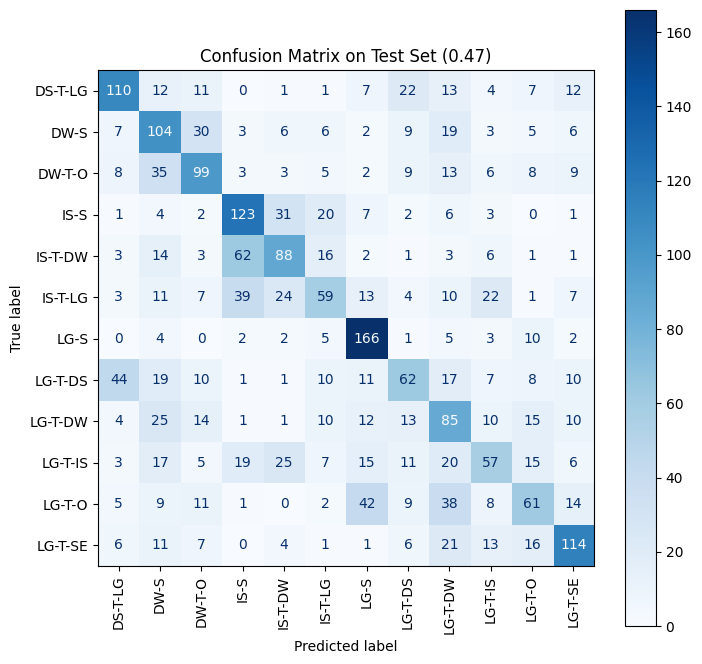

In [15]:
# assess model
preds, trues = evaluate_model(
    pre_model,
    test_loader,
    device,
    target_transform.classes_
)

Confusion matrix shows that the model gets stuck on images that has similar features. For example, LG-T-DS stands for Level Ground Transition Down Stairs, and the label DS-T-LG is the same but in inverted order. Looking at the images, we can say that the model struggles assigning the correct label when stairs has landings. In general, misclassification happens when model is not able to find differences between images of other classes.  
Each image corresponds to a frame in a video. Therefore, a precise classification must involve considering past frames as context. In this way, the model could be able to differentiate better the current frame.  

Before to train a model with a LSTM model, would be great to get into the model's black box and understand what is going on there. 


# Explain what CNN looks at

In [16]:
# Normalization
def tensor_normalization(image):
    """
    Description:
    Normalize tensor image ranging pixels between [0,1]
    
    image: 3D tensor (C,H,W)
    """
    return (image - image.min()) / (image.max() - image.min())

# plot grad_cam
def plot_grad_cam(
    images,
    heatmaps,
    true_labels=None,
    pred_labels=None,
    main_title="",
    use_fig_title=True
):
    """
    Description:
    Plot tensor images, heatmaps and a mixed image-heatmap to 
    see clearly where image's regions the network is looking at 
    for discrimate its class.
    
    images: 4D tensor with shape (N,C,H,W)
    heatmaps: 4D tensor with shape (N,C,H,W)
    true_labels: array of N true labels
    pred_labels: array of N predicted labels
    main_title: figure title. Used when use_fig_title is True
    use_fig_title: indicates if a fig title should be used.
    """
    # Set number of cols and rows
    rows = 3
    cols = images.shape[0]
    fig, axs = plt.subplots(rows, cols, figsize=(25,12))
    if use_fig_title:
        fig.suptitle(main_title, fontsize=16, fontweight='bold')

    for idx, (image, heatmap) in enumerate(zip(images, heatmaps)):
        # normalization
        image = tensor_normalization(image)
        heatmap = tensor_normalization(heatmap)
    
        # rearrange dimensions
        _image = image.permute(1,2,0)
        _image = _image.detach().cpu().numpy()
    
        _heatmap = heatmap.permute(1,2,0)
        _heatmap = _heatmap.detach().cpu().numpy()

        axs[0, idx].imshow(_image)
        axs[0, idx].axis('off')
        
        axs[1, idx].imshow(_heatmap, cmap="jet")
        axs[1, idx].axis('off')
    
        axs[2, idx].imshow(_image)
        axs[2, idx].imshow(_heatmap, cmap="jet", alpha=0.4)
        axs[2, idx].axis('off')

        # define titles
        if not use_fig_title:
            axs[0][idx].set_title(true_labels[idx])
            axs[1][idx].set_title(pred_labels[idx])
    
    plt.tight_layout()
    plt.show()

In [17]:
def filter_test_images(
    true_label,
    predicted_label,
    trues=trues,
    preds=preds,
    n_images=10,
    label_encoder=target_transform,
    dataset=test_dataset
):
    """
    Description:
    Filter test images based on the true label's value. The true label's value 
    could be a string or number. The number type represents the encoded version
    of the label.
    """
    
    # encode labels
    true_label = label_encoder.transform([true_label])
    predicted_label = label_encoder.transform([predicted_label])

    # filter images by true and predicted label, then get the intersection between both
    trues_idx = np.argwhere(true_label==trues).flatten().tolist()
    pred_idx = np.argwhere(predicted_label==preds).flatten().tolist()

    set_trues = set(trues_idx)
    set_preds = set(pred_idx)

    true_preds_idx = np.array(list(set_trues & set_preds))
    print(f"Total samples: {len(true_preds_idx)}")

    if n_images > len(true_preds_idx):
        warnings.warn(f"Filtered images length is less than number of images required: {n_images} > {len(true_preds_idx)}")
    else:
        true_preds_idx = np.random.choice(true_preds_idx, size=n_images)

    return torch.stack([dataset[idx][0] for idx in true_preds_idx], dim=0)

def compute_grad_cam_heatmaps(
    input_tensors,
    true_labels,
    model=pre_model
):
    """
    Description:
    Computes heatmap of input tensors
    """
    # setup grad_cam
    target_layers = [model.features[-1]]
    cam = GradCAM(model=model, target_layers=target_layers)

    # compute heatmaps
    heatmaps = []
    for idx in range(input_tensors.shape[0]):
        # define input tensor
        input_tensor = input_tensors[idx].unsqueeze(0)
        input_tensor.requires_grad_(True)

        # define targets
        targets = [ClassifierOutputTarget(true_labels[idx])]

        # comput heatmaps using grad_cam method
        heatmap = cam(input_tensor=input_tensor, targets=targets)
        heatmaps.append(torch.from_numpy(heatmap))

    return torch.stack(heatmaps, dim=0)


In [50]:
# Analize images
def inspect_test_images(
    true_pred_labels,
    n_images,
    trues,
    preds,
    label_encoder=target_transform
):
    """
    Description:
    Iterate over true, pred labels tuple ploting grad_cam heatmaps
    """
    for true_label, pred_label in true_pred_labels:
        
        filtered_images = filter_test_images(
            true_label=true_label,
            predicted_label=pred_label,
            n_images=n_images,
            trues=trues,
            preds=preds,
            label_encoder=target_transform
        )
        print(f"Filtered images: {filtered_images.shape}")

        n_images = filtered_images.shape[0]
        true_labels = [ true_label for _ in range(n_images) ]
        pred_labels = [ pred_label for _ in range(n_images) ]
        
        encoded_true_labels = target_transform.transform(true_labels)        
        heatmaps = compute_grad_cam_heatmaps(
            input_tensors=filtered_images,
            true_labels=encoded_true_labels
        )
        print(f"Heatmaps' shape: {heatmaps.shape}")
        
        plot_grad_cam(filtered_images, heatmaps, main_title=f"True: {true_label} - Pred: {pred_label}")

Total samples: 62
Filtered images: torch.Size([5, 3, 456, 456])
Heatmaps' shape: torch.Size([5, 1, 456, 456])


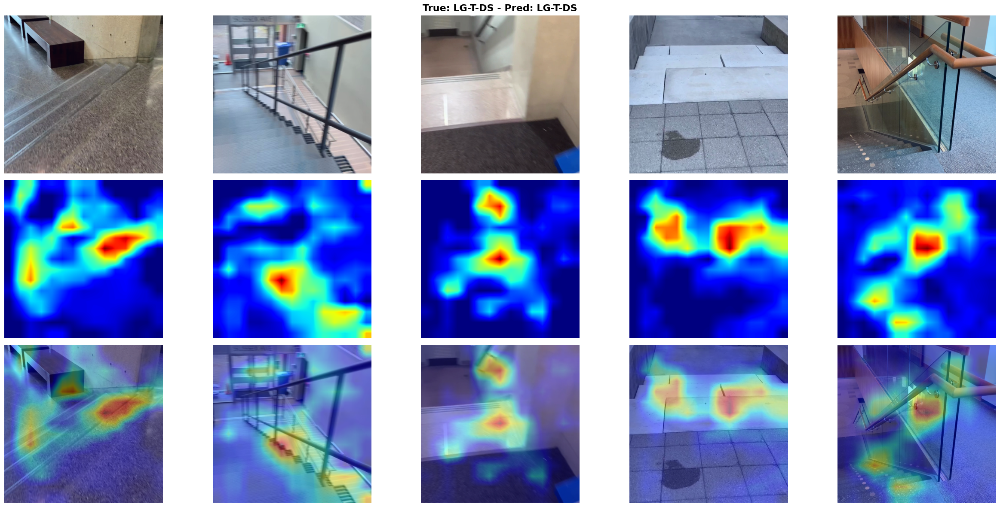

Total samples: 110
Filtered images: torch.Size([5, 3, 456, 456])
Heatmaps' shape: torch.Size([5, 1, 456, 456])


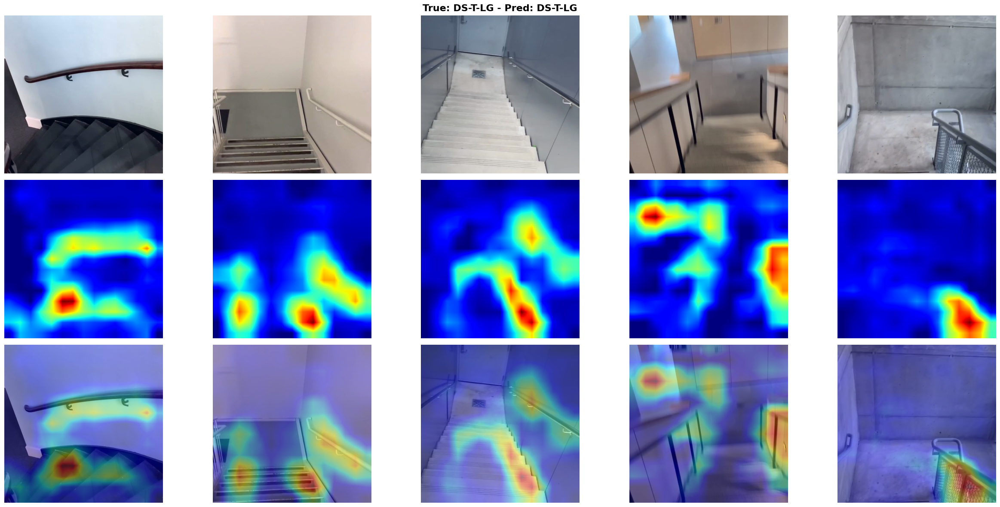

Total samples: 44
Filtered images: torch.Size([5, 3, 456, 456])
Heatmaps' shape: torch.Size([5, 1, 456, 456])


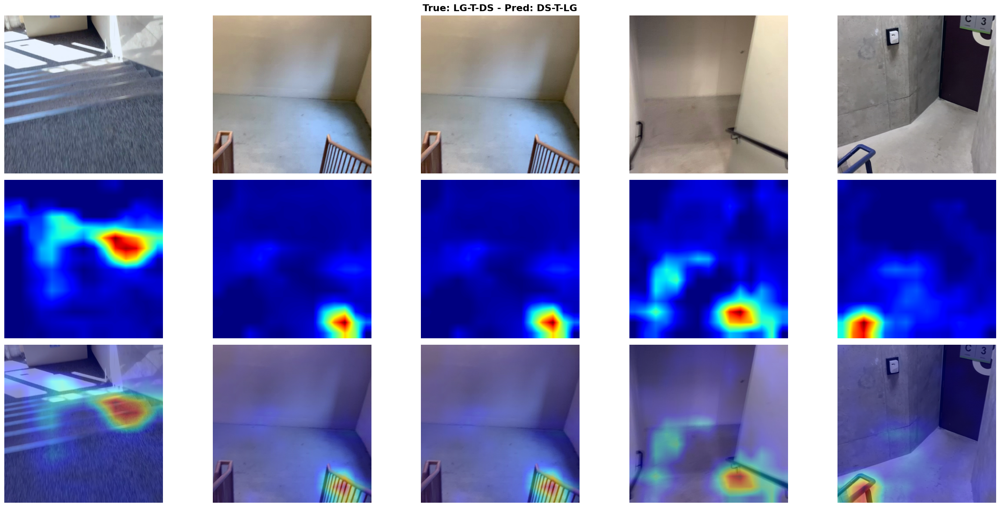

In [19]:
labels_inspection = [
    ('LG-T-DS', 'LG-T-DS'),
    ('DS-T-LG', 'DS-T-LG'),
    ('LG-T-DS', 'DS-T-LG')
]
inspect_test_images(labels_inspection, n_images=5, trues=trues, preds=preds)

As we can see, neural network doesn't look at similar regions on images belonging to the same class. CNN seems to be guessing what label to assign instead of looking stairs or wall or any reasonable region.  

Transfer learning seems to be a weak method to tackle this problem. We can start fine-tuning the CNN to get better results.

# Fine-tuning
The following parameters are defined similar to Laschowski paper *(Environment Classification for Robotic Leg Prostheses and Exoskeletons Using Deep Convolutional Neural Networks).*

In [20]:
# define model
ft_model, device = get_efficientnet_b7(fine_tuning=True, last_layers=4)

# Create dataset
ft_train_dataset = create_dataset(train_df)
ft_val_dataset = create_dataset(val_df)

# Create dataloaders
ft_train_loader = DataLoader(
    ft_train_dataset,
    batch_size=128, # as described in the paper
    shuffle=True,
    num_workers=3,
    pin_memory=True
)
ft_val_loader = DataLoader(
    ft_val_dataset,
    batch_size=128, # as described in the paper
    shuffle=True,
    num_workers=3,
    pin_memory=True
)

# define criterion and optimizers
ft_learning_rate = 1e-3 # as described in the paper
ft_criterion = torch.nn.CrossEntropyLoss()
ft_optimizer = torch.optim.Adam(ft_model.parameters(), lr=ft_learning_rate) # same method as described in the paper
ft_epochs = 40 # as described in the paper
ft_lr_decay_scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(ft_optimizer, T_max=ft_epochs, eta_min=1e-6) # same method as described in the paper
ft_checkpoint_path = "states\\ft_efficientnetb7.pth"
ft_checkpoint_path_best = "states\\ft_efficientnetb7_best.pth"

In [21]:
# how many params are trainables?
trainable_params = sum(p.numel() for p in ft_model.parameters() if p.requires_grad)
print("Trainable parameters:", trainable_params)

Trainable parameters: 3310932


In [40]:
# restore states if previous training's been done already
ft_model, ft_optimizer, ft_history, ft_current_epoch, ft_lr_decay_scheduler = setup_training_params(
    ft_model,
    ft_optimizer,
    ft_checkpoint_path,
    ft_lr_decay_scheduler
)

ft_model = train_model(
    ft_model,
    ft_criterion,
    ft_optimizer,
    ft_train_loader,
    ft_val_loader,
    ft_epochs,
    device,
    ft_checkpoint_path,
    ft_checkpoint_path_best,
    ft_current_epoch,
    ft_history,
    ft_lr_decay_scheduler
)

The state couldn't be loaded. Exception: [Errno 2] No such file or directory: 'states\\ft_efficientnetb7.pth'


Epoch 1/40 [Val]: 100%|███████████████████████████████████████| 38/38 [07:07<00:00, 11.25s/batch, loss=1.7, acc=0.4794]



Epoch 1 Summary:
  Train Loss: 1.7726 | Train Acc: 0.4087
  Val Loss:   1.5831 | Val Acc:   0.4794


Epoch 2/40 [Val]: 100%|███████████████████████████████████████| 38/38 [05:49<00:00,  9.21s/batch, loss=1.5, acc=0.5258]



Epoch 2 Summary:
  Train Loss: 1.4565 | Train Acc: 0.5223
  Val Loss:   1.4753 | Val Acc:   0.5258


Epoch 3/40 [Val]: 100%|██████████████████████████████████████| 38/38 [05:40<00:00,  8.96s/batch, loss=1.65, acc=0.5190]



Epoch 3 Summary:
  Train Loss: 1.3156 | Train Acc: 0.5666
  Val Loss:   1.4694 | Val Acc:   0.5190


Epoch 4/40 [Val]: 100%|██████████████████████████████████████| 38/38 [07:30<00:00, 11.86s/batch, loss=1.31, acc=0.5256]



Epoch 4 Summary:
  Train Loss: 1.1938 | Train Acc: 0.6079
  Val Loss:   1.4686 | Val Acc:   0.5256


Epoch 5/40 [Val]: 100%|██████████████████████████████████████| 38/38 [06:18<00:00,  9.96s/batch, loss=1.63, acc=0.5356]



Epoch 5 Summary:
  Train Loss: 1.0646 | Train Acc: 0.6485
  Val Loss:   1.4545 | Val Acc:   0.5356


Epoch 6/40 [Val]: 100%|██████████████████████████████████████| 38/38 [05:45<00:00,  9.10s/batch, loss=1.63, acc=0.5454]



Epoch 6 Summary:
  Train Loss: 0.9359 | Train Acc: 0.6900
  Val Loss:   1.5013 | Val Acc:   0.5454


Epoch 7/40 [Val]: 100%|██████████████████████████████████████| 38/38 [05:41<00:00,  9.00s/batch, loss=1.66, acc=0.5323]



Epoch 7 Summary:
  Train Loss: 0.8059 | Train Acc: 0.7345
  Val Loss:   1.5193 | Val Acc:   0.5323


Epoch 8/40 [Val]: 100%|███████████████████████████████████████| 38/38 [05:48<00:00,  9.18s/batch, loss=1.8, acc=0.5423]



Epoch 8 Summary:
  Train Loss: 0.6895 | Train Acc: 0.7764
  Val Loss:   1.5508 | Val Acc:   0.5423


Epoch 9/40 [Val]: 100%|██████████████████████████████████████| 38/38 [05:45<00:00,  9.09s/batch, loss=1.27, acc=0.5377]



Epoch 9 Summary:
  Train Loss: 0.5675 | Train Acc: 0.8173
  Val Loss:   1.6215 | Val Acc:   0.5377


Epoch 10/40 [Val]: 100%|█████████████████████████████████████| 38/38 [05:55<00:00,  9.37s/batch, loss=1.76, acc=0.5473]



Epoch 10 Summary:
  Train Loss: 0.4677 | Train Acc: 0.8500
  Val Loss:   1.6637 | Val Acc:   0.5473


Epoch 11/40 [Val]: 100%|█████████████████████████████████████| 38/38 [05:43<00:00,  9.03s/batch, loss=1.66, acc=0.5442]



Epoch 11 Summary:
  Train Loss: 0.3809 | Train Acc: 0.8796
  Val Loss:   1.7809 | Val Acc:   0.5442


Epoch 12/40 [Val]: 100%|█████████████████████████████████████| 38/38 [05:48<00:00,  9.18s/batch, loss=1.98, acc=0.5475]



Epoch 12 Summary:
  Train Loss: 0.3177 | Train Acc: 0.9015
  Val Loss:   1.8479 | Val Acc:   0.5475


Epoch 13/40 [Val]: 100%|██████████████████████████████████████| 38/38 [05:39<00:00,  8.94s/batch, loss=1.9, acc=0.5419]



Epoch 13 Summary:
  Train Loss: 0.2618 | Train Acc: 0.9204
  Val Loss:   1.8781 | Val Acc:   0.5419


Epoch 14/40 [Val]: 100%|█████████████████████████████████████| 38/38 [05:38<00:00,  8.91s/batch, loss=1.75, acc=0.5367]



Epoch 14 Summary:
  Train Loss: 0.2095 | Train Acc: 0.9356
  Val Loss:   2.0166 | Val Acc:   0.5367


Epoch 15/40 [Val]: 100%|█████████████████████████████████████| 38/38 [05:40<00:00,  8.97s/batch, loss=1.63, acc=0.5469]



Epoch 15 Summary:
  Train Loss: 0.1858 | Train Acc: 0.9467
  Val Loss:   2.0255 | Val Acc:   0.5469


Epoch 16/40 [Val]: 100%|█████████████████████████████████████| 38/38 [05:38<00:00,  8.91s/batch, loss=2.11, acc=0.5475]



Epoch 16 Summary:
  Train Loss: 0.1582 | Train Acc: 0.9527
  Val Loss:   2.0715 | Val Acc:   0.5475


Epoch 17/40 [Val]: 100%|█████████████████████████████████████| 38/38 [05:40<00:00,  8.97s/batch, loss=2.69, acc=0.5508]



Epoch 17 Summary:
  Train Loss: 0.1423 | Train Acc: 0.9583
  Val Loss:   2.1415 | Val Acc:   0.5508


Epoch 18/40 [Val]: 100%|█████████████████████████████████████| 38/38 [05:39<00:00,  8.93s/batch, loss=2.17, acc=0.5390]



Epoch 18 Summary:
  Train Loss: 0.1203 | Train Acc: 0.9664
  Val Loss:   2.1533 | Val Acc:   0.5390


Epoch 19/40 [Val]: 100%|█████████████████████████████████████| 38/38 [05:39<00:00,  8.95s/batch, loss=2.42, acc=0.5460]



Epoch 19 Summary:
  Train Loss: 0.1045 | Train Acc: 0.9709
  Val Loss:   2.2060 | Val Acc:   0.5460


Epoch 20/40 [Val]: 100%|█████████████████████████████████████| 38/38 [05:41<00:00,  8.98s/batch, loss=2.26, acc=0.5450]



Epoch 20 Summary:
  Train Loss: 0.0956 | Train Acc: 0.9726
  Val Loss:   2.2511 | Val Acc:   0.5450


Epoch 21/40 [Val]: 100%|█████████████████████████████████████| 38/38 [05:41<00:00,  8.97s/batch, loss=2.25, acc=0.5502]



Epoch 21 Summary:
  Train Loss: 0.0836 | Train Acc: 0.9762
  Val Loss:   2.2773 | Val Acc:   0.5502


Epoch 22/40 [Val]: 100%|█████████████████████████████████████| 38/38 [05:59<00:00,  9.47s/batch, loss=2.21, acc=0.5548]



Epoch 22 Summary:
  Train Loss: 0.0724 | Train Acc: 0.9793
  Val Loss:   2.2960 | Val Acc:   0.5548


Epoch 23/40 [Val]: 100%|█████████████████████████████████████| 38/38 [07:18<00:00, 11.53s/batch, loss=3.33, acc=0.5481]



Epoch 23 Summary:
  Train Loss: 0.0661 | Train Acc: 0.9812
  Val Loss:   2.3334 | Val Acc:   0.5481


Epoch 24/40 [Val]: 100%|██████████████████████████████████████| 38/38 [05:49<00:00,  9.21s/batch, loss=2.2, acc=0.5565]



Epoch 24 Summary:
  Train Loss: 0.0571 | Train Acc: 0.9842
  Val Loss:   2.3739 | Val Acc:   0.5565


Epoch 25/40 [Val]: 100%|██████████████████████████████████████| 38/38 [05:43<00:00,  9.04s/batch, loss=1.7, acc=0.5544]



Epoch 25 Summary:
  Train Loss: 0.0542 | Train Acc: 0.9851
  Val Loss:   2.4239 | Val Acc:   0.5544


Epoch 26/40 [Val]: 100%|██████████████████████████████████████| 38/38 [07:20<00:00, 11.60s/batch, loss=2.2, acc=0.5513]



Epoch 26 Summary:
  Train Loss: 0.0522 | Train Acc: 0.9864
  Val Loss:   2.4054 | Val Acc:   0.5513


Epoch 27/40 [Val]: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 38/38 [07:22<00:00, 11.64s/batch, loss=2.4, acc=0.5498]



Epoch 27 Summary:
  Train Loss: 0.0427 | Train Acc: 0.9885
  Val Loss:   2.4076 | Val Acc:   0.5498


Epoch 28/40 [Val]: 100%|████████████| 38/38 [05:40<00:00,  8.95s/batch, loss=2.38, acc=0.5552]



Epoch 28 Summary:
  Train Loss: 0.0398 | Train Acc: 0.9898
  Val Loss:   2.4585 | Val Acc:   0.5552


Epoch 29/40 [Val]: 100%|████████████| 38/38 [05:39<00:00,  8.95s/batch, loss=2.24, acc=0.5556]



Epoch 29 Summary:
  Train Loss: 0.0373 | Train Acc: 0.9902
  Val Loss:   2.4673 | Val Acc:   0.5556


Epoch 30/40 [Val]: 100%|████████████| 38/38 [05:49<00:00,  9.20s/batch, loss=1.88, acc=0.5602]



Epoch 30 Summary:
  Train Loss: 0.0346 | Train Acc: 0.9910
  Val Loss:   2.4530 | Val Acc:   0.5602


Epoch 31/40 [Val]: 100%|████████████| 38/38 [05:42<00:00,  9.02s/batch, loss=2.29, acc=0.5619]



Epoch 31 Summary:
  Train Loss: 0.0336 | Train Acc: 0.9914
  Val Loss:   2.4733 | Val Acc:   0.5619


Epoch 32/40 [Val]: 100%|████████████| 38/38 [05:38<00:00,  8.92s/batch, loss=2.47, acc=0.5613]



Epoch 32 Summary:
  Train Loss: 0.0305 | Train Acc: 0.9920
  Val Loss:   2.4862 | Val Acc:   0.5613


Epoch 33/40 [Val]: 100%|████████████| 38/38 [05:39<00:00,  8.92s/batch, loss=3.19, acc=0.5604]



Epoch 33 Summary:
  Train Loss: 0.0296 | Train Acc: 0.9920
  Val Loss:   2.4925 | Val Acc:   0.5604


Epoch 34/40 [Val]: 100%|████████████| 38/38 [05:40<00:00,  8.96s/batch, loss=2.97, acc=0.5604]



Epoch 34 Summary:
  Train Loss: 0.0261 | Train Acc: 0.9933
  Val Loss:   2.4897 | Val Acc:   0.5604


Epoch 35/40 [Val]: 100%|████████████| 38/38 [05:48<00:00,  9.16s/batch, loss=2.67, acc=0.5621]



Epoch 35 Summary:
  Train Loss: 0.0259 | Train Acc: 0.9932
  Val Loss:   2.4854 | Val Acc:   0.5621


Epoch 36/40 [Val]: 100%|████████████| 38/38 [05:46<00:00,  9.13s/batch, loss=3.32, acc=0.5633]



Epoch 36 Summary:
  Train Loss: 0.0238 | Train Acc: 0.9939
  Val Loss:   2.4995 | Val Acc:   0.5633


Epoch 37/40 [Val]: 100%|████████████| 38/38 [05:39<00:00,  8.94s/batch, loss=2.14, acc=0.5629]



Epoch 37 Summary:
  Train Loss: 0.0240 | Train Acc: 0.9942
  Val Loss:   2.5027 | Val Acc:   0.5629


Epoch 38/40 [Val]: 100%|████████████| 38/38 [05:39<00:00,  8.93s/batch, loss=2.32, acc=0.5625]



Epoch 38 Summary:
  Train Loss: 0.0243 | Train Acc: 0.9940
  Val Loss:   2.4999 | Val Acc:   0.5625


Epoch 39/40 [Val]: 100%|████████████| 38/38 [05:38<00:00,  8.92s/batch, loss=2.48, acc=0.5623]



Epoch 39 Summary:
  Train Loss: 0.0238 | Train Acc: 0.9949
  Val Loss:   2.5051 | Val Acc:   0.5623


Epoch 40/40 [Val]: 100%|████████████| 38/38 [05:40<00:00,  8.95s/batch, loss=2.65, acc=0.5617]


Epoch 40 Summary:
  Train Loss: 0.0233 | Train Acc: 0.9940
  Val Loss:   2.5036 | Val Acc:   0.5617

Training complete!


In [22]:
# Load best model
ft_checkpoint = torch.load(ft_checkpoint_path_best, map_location=device)
ft_model.load_state_dict(ft_checkpoint["model_state_dict"])

<All keys matched successfully>

In [23]:
# create dataset for testing
ft_test_dataset = create_dataset(test_df)

# create dataloader for testing
tf_test_loader = DataLoader(
    ft_test_dataset,
    batch_size=64,
    shuffle=False,
    num_workers=4,
    pin_memory=True
)

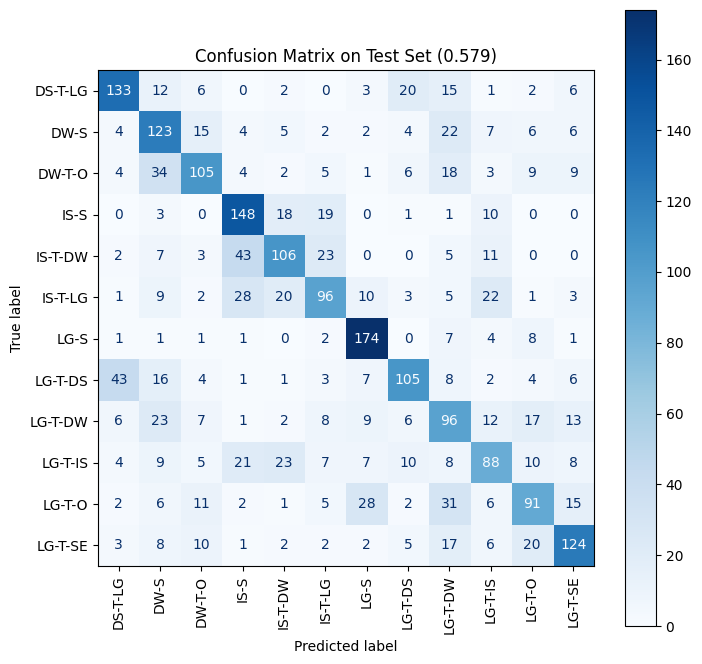

In [24]:
# assess model
ft_preds, ft_trues = evaluate_model(
    ft_model,
    tf_test_loader,
    device,
    target_transform.classes_
)

Total samples: 174
Filtered images: torch.Size([5, 3, 456, 456])
Heatmaps' shape: torch.Size([5, 1, 456, 456])


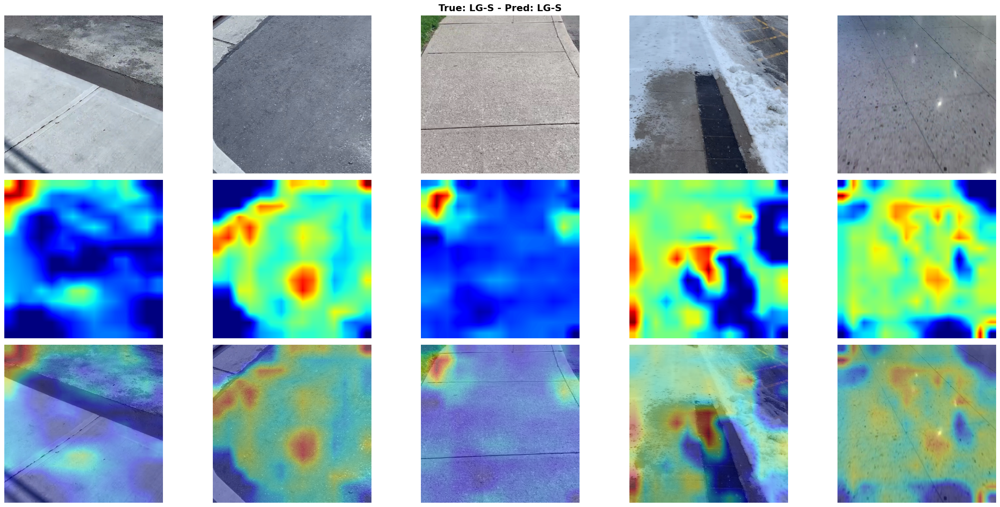

Total samples: 43
Filtered images: torch.Size([5, 3, 456, 456])
Heatmaps' shape: torch.Size([5, 1, 456, 456])


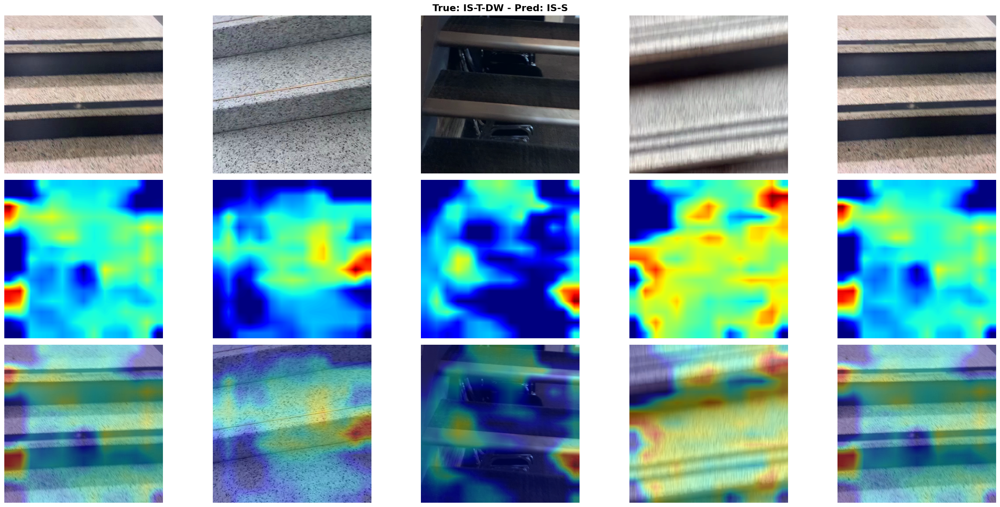

Total samples: 43
Filtered images: torch.Size([5, 3, 456, 456])
Heatmaps' shape: torch.Size([5, 1, 456, 456])


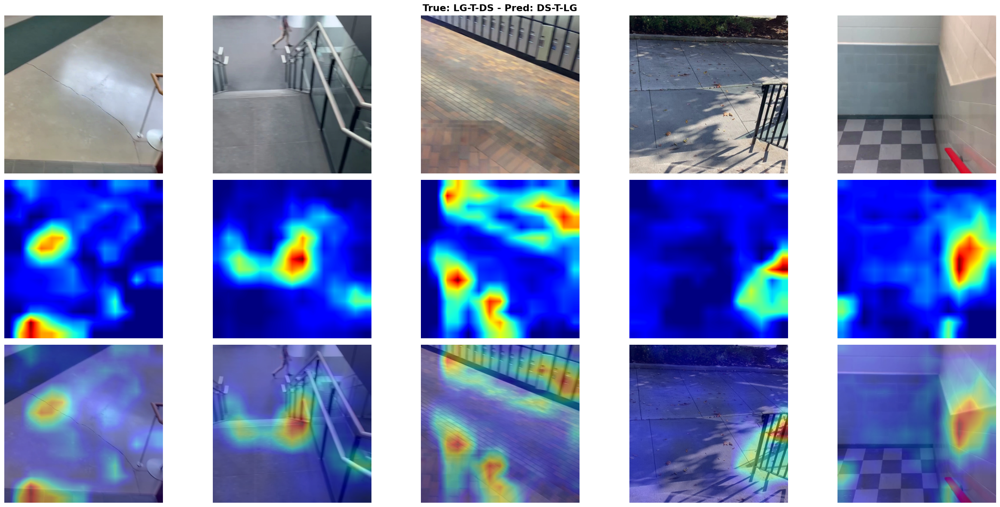

Total samples: 105
Filtered images: torch.Size([5, 3, 456, 456])
Heatmaps' shape: torch.Size([5, 1, 456, 456])


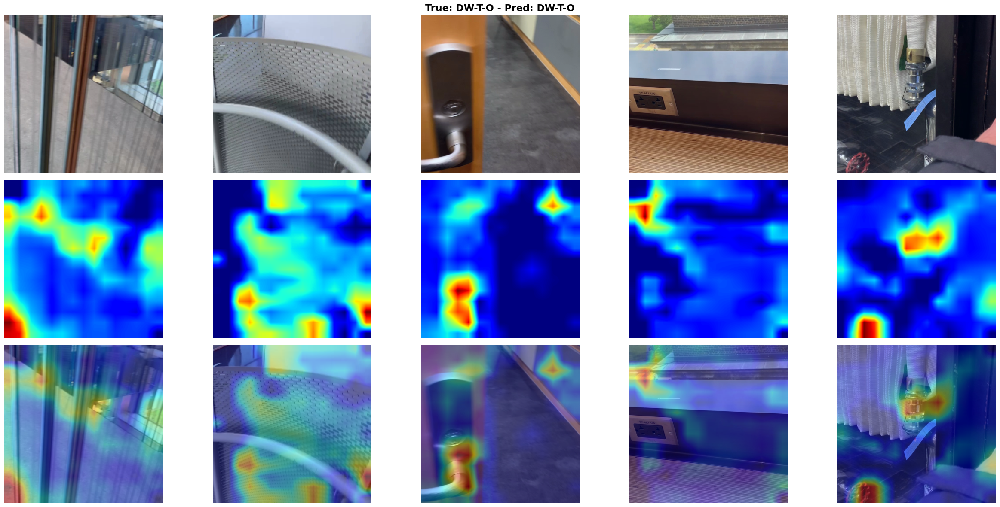

In [25]:
labels_inspection = [
    ('LG-S', 'LG-S'),
    ('IS-T-DW', 'IS-S'),
    ('LG-T-DS', 'DS-T-LG'),
    ('DW-T-O', 'DW-T-O')
]
inspect_test_images(labels_inspection, n_images=5, trues=ft_trues, preds=ft_preds)

## Discussion
La red reconoce ambientes relativamente bien, pero se complica en predecir transiciones puesto a que no hay una diferencia entre algunas transiciones si se los ve como frames independientes. Por ejemplo, la clase LG-T-DS y DS-T-LG, la cual indica Level Ground - Transition - Decline Stairs y Decline Stairs - Transition - Level Ground, no mantiene una gran diferencia entre la una clase y la otra. Además, el etiquetado podría traer problemas en el entrenamiento ya que algunas imágenes están fuertemente ligadas a la percepción de cuando una imagen deja de ser de una clase para convertirse en otra clase. 

Ya que la red CNN va a ser usada para obtener los features maps de las imágenes, es necesario crear un nuevo etiquetado de las imágenes para diferenciar ambientes y ciertas condiciones de la base de datos ExoNet. 

In [39]:
new_df = df.copy()
new_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 922782 entries, 0 to 922781
Data columns (total 4 columns):
 #   Column  Non-Null Count   Dtype 
---  ------  --------------   ----- 
 0   video   922782 non-null  object
 1   frame   922782 non-null  int64 
 2   class   922782 non-null  object
 3   exist   922782 non-null  bool  
dtypes: bool(1), int64(1), object(2)
memory usage: 22.0+ MB


- IS-S -> Stairs
- IS-T-DW -> Stairs
- IS-T-LG -> Stairs
- DW-S -> Door-Wall
- DW-T-O -> Other
- DS-T-LG -> Stairs (existe un enfoque más hacia las escaleras que al piso)
- LG-S -> Level-Ground
- LG-T-DS -> Level-Ground
- LG-T-DW -> Level-Ground
- LG-T-IS -> Level-Ground
- LG-T-O -> Other
- LG-T-SE -> Seat

In [40]:
# define map 
new_classes = {
    "IS-S": "Stairs",
    "IS-T-DW": "Stairs",
    "IS-T-LG": "Stairs",
    "DW-S": "Door-Wall",
    "DW-T-O": "Other",
    "DS-T-LG": "Stairs",
    "LG-S": "Level-Ground",
    "LG-T-DS": "Level-Ground",
    "LG-T-DW": "Level-Ground",
    "LG-T-IS": "Level-Ground",
    "LG-T-O": "Other",
    "LG-T-SE": "Seat"
}

# map classes to new ones
new_df['virtual_class'] = df['class'].map(new_classes)
new_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 922782 entries, 0 to 922781
Data columns (total 5 columns):
 #   Column         Non-Null Count   Dtype 
---  ------         --------------   ----- 
 0   video          922782 non-null  object
 1   frame          922782 non-null  int64 
 2   class          922782 non-null  object
 3   exist          922782 non-null  bool  
 4   virtual_class  922782 non-null  object
dtypes: bool(1), int64(1), object(3)
memory usage: 29.0+ MB


In [43]:
# generate new set of train, val and test dataframes
new_unique_classes = new_df['virtual_class'].unique()
print("New unique classes: ", new_unique_classes)
new_train_df, new_val_df, new_test_df = generate_fair_dataset(new_df, new_unique_classes, class_column_name="virtual_class")

print(f"Train df rows: {len(new_train_df)}\nValidation df rows: {len(new_val_df)}\nTest df rows: {len(new_test_df)}")

New unique classes:  ['Level-Ground' 'Other' 'Door-Wall' 'Seat' 'Stairs']
Train df rows: 10000
Validation df rows: 2000
Test df rows: 1000


In [44]:
# define model
ft_model, device = get_efficientnet_b7(fine_tuning=True, last_layers=4)

# transform
target_transform = LabelEncoder()
target_transform.fit(new_unique_classes)

# Create dataset
ft_train_dataset = create_dataset(
    new_train_df,
    target_transform=target_transform,
    virtual_classname="virtual_class"
)
ft_val_dataset = create_dataset(
    new_val_df,
    target_transform=target_transform,
    virtual_classname="virtual_class"
)

# Create dataloaders
ft_train_loader = DataLoader(
    ft_train_dataset,
    batch_size=128, # as described in the paper
    shuffle=True,
    num_workers=3,
    pin_memory=True
)
ft_val_loader = DataLoader(
    ft_val_dataset,
    batch_size=128, # as described in the paper
    shuffle=True,
    num_workers=3,
    pin_memory=True
)

# define criterion and optimizers
ft_learning_rate = 1e-3 # as described in the paper
ft_criterion = torch.nn.CrossEntropyLoss()
ft_optimizer = torch.optim.Adam(ft_model.parameters(), lr=ft_learning_rate) # same method as described in the paper
ft_epochs = 40 # as described in the paper
ft_lr_decay_scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(ft_optimizer, T_max=ft_epochs, eta_min=1e-6) # same method as described in the paper
ft_checkpoint_path = "states\\map_classes_ft_efficientnetb5.pth"
ft_checkpoint_path_best = "states\\map_classes_ft_efficientnetb5_best.pth"

In [45]:
# restore states if previous training's been done already
ft_model, ft_optimizer, ft_history, ft_current_epoch, ft_lr_decay_scheduler = setup_training_params(
    ft_model,
    ft_optimizer,
    ft_checkpoint_path,
    ft_lr_decay_scheduler
)

ft_model = train_model(
    ft_model,
    ft_criterion,
    ft_optimizer,
    ft_train_loader,
    ft_val_loader,
    ft_epochs,
    device,
    ft_checkpoint_path,
    ft_checkpoint_path_best,
    ft_current_epoch,
    ft_history,
    ft_lr_decay_scheduler
)

The state couldn't be loaded. Exception: [Errno 2] No such file or directory: 'states\\map_classes_ft_efficientnetb5.pth'


Epoch 1/40 [Val]: 100%|██████████████████████████████████████| 16/16 [02:22<00:00,  8.92s/batch, loss=1.46, acc=0.5215]



Epoch 1 Summary:
  Train Loss: 0.5989 | Train Acc: 0.4762
  Val Loss:   0.5701 | Val Acc:   0.5215


Epoch 2/40 [Val]: 100%|██████████████████████████████████████| 16/16 [02:21<00:00,  8.83s/batch, loss=1.11, acc=0.5875]



Epoch 2 Summary:
  Train Loss: 0.4297 | Train Acc: 0.6158
  Val Loss:   0.4622 | Val Acc:   0.5875


Epoch 3/40 [Val]: 100%|█████████████████████████████████████| 16/16 [02:22<00:00,  8.94s/batch, loss=0.943, acc=0.6280]



Epoch 3 Summary:
  Train Loss: 0.3738 | Train Acc: 0.6670
  Val Loss:   0.4233 | Val Acc:   0.6280


Epoch 4/40 [Val]: 100%|██████████████████████████████████████| 16/16 [02:23<00:00,  8.99s/batch, loss=1.23, acc=0.6285]



Epoch 4 Summary:
  Train Loss: 0.3177 | Train Acc: 0.7267
  Val Loss:   0.4298 | Val Acc:   0.6285


Epoch 5/40 [Val]: 100%|█████████████████████████████████████| 16/16 [02:20<00:00,  8.79s/batch, loss=0.957, acc=0.6310]



Epoch 5 Summary:
  Train Loss: 0.2588 | Train Acc: 0.7825
  Val Loss:   0.4530 | Val Acc:   0.6310


Epoch 6/40 [Val]: 100%|██████████████████████████████████████| 16/16 [02:21<00:00,  8.84s/batch, loss=1.05, acc=0.6280]



Epoch 6 Summary:
  Train Loss: 0.1983 | Train Acc: 0.8436
  Val Loss:   0.4539 | Val Acc:   0.6280


Epoch 7/40 [Val]: 100%|█████████████████████████████████████| 16/16 [02:20<00:00,  8.77s/batch, loss=0.937, acc=0.6175]



Epoch 7 Summary:
  Train Loss: 0.1476 | Train Acc: 0.8862
  Val Loss:   0.4905 | Val Acc:   0.6175


Epoch 8/40 [Val]: 100%|█████████████████████████████████████| 16/16 [02:20<00:00,  8.79s/batch, loss=0.985, acc=0.6255]



Epoch 8 Summary:
  Train Loss: 0.1024 | Train Acc: 0.9247
  Val Loss:   0.5316 | Val Acc:   0.6255


Epoch 9/40 [Val]: 100%|██████████████████████████████████████| 16/16 [02:21<00:00,  8.82s/batch, loss=1.23, acc=0.6230]



Epoch 9 Summary:
  Train Loss: 0.0768 | Train Acc: 0.9492
  Val Loss:   0.5577 | Val Acc:   0.6230


Epoch 10/40 [Val]: 100%|█████████████████████████████████████| 16/16 [02:21<00:00,  8.85s/batch, loss=1.54, acc=0.6155]



Epoch 10 Summary:
  Train Loss: 0.0588 | Train Acc: 0.9603
  Val Loss:   0.5950 | Val Acc:   0.6155


Epoch 11/40 [Val]: 100%|█████████████████████████████████████| 16/16 [02:21<00:00,  8.86s/batch, loss=1.79, acc=0.6220]



Epoch 11 Summary:
  Train Loss: 0.0535 | Train Acc: 0.9643
  Val Loss:   0.6265 | Val Acc:   0.6220


Epoch 12/40 [Val]: 100%|█████████████████████████████████████| 16/16 [02:21<00:00,  8.84s/batch, loss=1.32, acc=0.6260]



Epoch 12 Summary:
  Train Loss: 0.0434 | Train Acc: 0.9705
  Val Loss:   0.6245 | Val Acc:   0.6260


Epoch 13/40 [Val]: 100%|█████████████████████████████████████| 16/16 [02:21<00:00,  8.85s/batch, loss=1.83, acc=0.6310]



Epoch 13 Summary:
  Train Loss: 0.0329 | Train Acc: 0.9782
  Val Loss:   0.6218 | Val Acc:   0.6310


Epoch 14/40 [Val]: 100%|█████████████████████████████████████| 16/16 [02:21<00:00,  8.85s/batch, loss=1.51, acc=0.6345]



Epoch 14 Summary:
  Train Loss: 0.0388 | Train Acc: 0.9731
  Val Loss:   0.6716 | Val Acc:   0.6345


Epoch 15/40 [Val]: 100%|█████████████████████████████████████| 16/16 [02:21<00:00,  8.84s/batch, loss=2.05, acc=0.6380]



Epoch 15 Summary:
  Train Loss: 0.0441 | Train Acc: 0.9679
  Val Loss:   0.6864 | Val Acc:   0.6380


Epoch 16/40 [Val]: 100%|██████████████████████████████████████| 16/16 [02:22<00:00,  8.88s/batch, loss=1.8, acc=0.6360]



Epoch 16 Summary:
  Train Loss: 0.0278 | Train Acc: 0.9819
  Val Loss:   0.6670 | Val Acc:   0.6360


Epoch 17/40 [Val]: 100%|█████████████████████████████████████| 16/16 [02:21<00:00,  8.82s/batch, loss=1.81, acc=0.6370]



Epoch 17 Summary:
  Train Loss: 0.0182 | Train Acc: 0.9886
  Val Loss:   0.6814 | Val Acc:   0.6370


Epoch 18/40 [Val]: 100%|█████████████████████████████████████| 16/16 [02:21<00:00,  8.84s/batch, loss=1.79, acc=0.6355]



Epoch 18 Summary:
  Train Loss: 0.0256 | Train Acc: 0.9805
  Val Loss:   0.6952 | Val Acc:   0.6355


Epoch 19/40 [Val]: 100%|█████████████████████████████████████| 16/16 [02:21<00:00,  8.81s/batch, loss=1.49, acc=0.6390]



Epoch 19 Summary:
  Train Loss: 0.0249 | Train Acc: 0.9820
  Val Loss:   0.6860 | Val Acc:   0.6390


Epoch 20/40 [Val]: 100%|██████████████████████████████████████| 16/16 [02:21<00:00,  8.82s/batch, loss=1.6, acc=0.6395]



Epoch 20 Summary:
  Train Loss: 0.0156 | Train Acc: 0.9903
  Val Loss:   0.7010 | Val Acc:   0.6395


Epoch 21/40 [Val]: 100%|█████████████████████████████████████| 16/16 [02:20<00:00,  8.81s/batch, loss=1.59, acc=0.6290]



Epoch 21 Summary:
  Train Loss: 0.0179 | Train Acc: 0.9887
  Val Loss:   0.7168 | Val Acc:   0.6290


Epoch 22/40 [Val]: 100%|█████████████████████████████████████| 16/16 [02:21<00:00,  8.82s/batch, loss=1.79, acc=0.6320]



Epoch 22 Summary:
  Train Loss: 0.0113 | Train Acc: 0.9942
  Val Loss:   0.7155 | Val Acc:   0.6320


Epoch 23/40 [Val]: 100%|█████████████████████████████████████| 16/16 [02:21<00:00,  8.85s/batch, loss=1.41, acc=0.6405]



Epoch 23 Summary:
  Train Loss: 0.0108 | Train Acc: 0.9936
  Val Loss:   0.7231 | Val Acc:   0.6405


Epoch 24/40 [Train]:   0%|                                                                   | 0/79 [00:24<?, ?batch/s]


KeyboardInterrupt: 

In [47]:
# create dataset for testing
ft_test_dataset = create_dataset(
    new_test_df,
    target_transform=target_transform,
    virtual_classname="virtual_class"
)

# create dataloader for testing
tf_test_loader = DataLoader(
    ft_test_dataset,
    batch_size=64,
    shuffle=False,
    num_workers=4,
    pin_memory=True
)

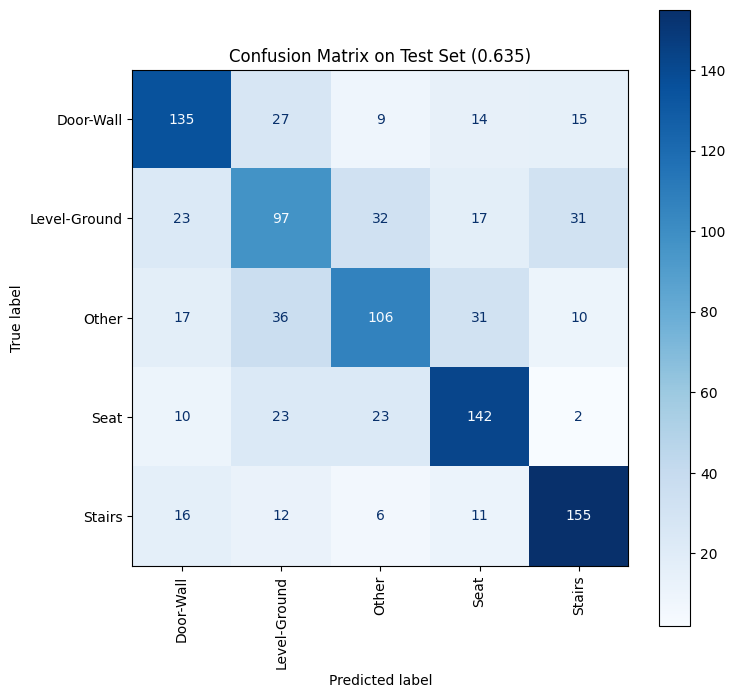

In [48]:
# assess model
ft_preds, ft_trues = evaluate_model(
    ft_model,
    tf_test_loader,
    device,
    target_transform.classes_
)

Total samples: 155
Filtered images: torch.Size([15, 3, 456, 456])
Heatmaps' shape: torch.Size([15, 1, 456, 456])


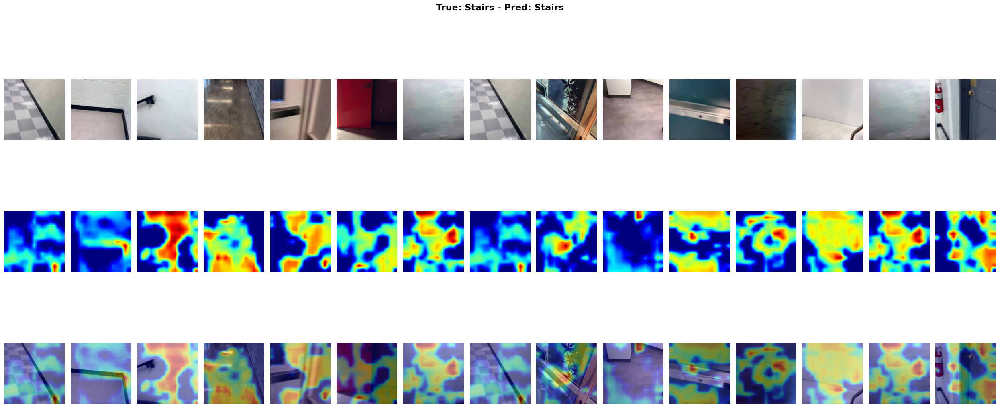

In [70]:
labels_inspection = [
    ('Stairs', 'Stairs')
]
inspect_test_images(labels_inspection, n_images=15, trues=ft_trues, preds=ft_preds, label_encoder=target_transform)